In [1]:
def concatenate_images(images, nrows, ncols,reversed = False, padding=0, background_color=(255, 255, 255)):
    """
    拼接图像列表为一个大图像。

    参数:
    images (list of PIL.Image): 要拼接的图像列表。
    nrows (int): 行数。
    ncols (int): 列数。
    padding (int): 图像之间的填充宽度（默认为0）。
    background_color (tuple): 填充区域的颜色（默认为白色）。

    返回:
    PIL.Image: 拼接后的图像。
    """
    total_images = nrows * ncols
    if len(images) < total_images:
        # 如果图像数量不足，创建空白图像填补空缺
        image_size = images[0].size if images else (100, 100)  # 默认大小为 100x100
        blank_images = [Image.new('RGB',image_size, background_color) for _ in range(total_images - len(images))]
        images.extend(blank_images)

    # 获取所有图像的宽度和高度
    widths, heights = zip(*(i.size for i in images))

    # 计算拼接后图像的总宽度和高度
    total_width = max(widths) * ncols + padding * (ncols - 1)
    total_height = max(heights) * nrows + padding * (nrows - 1)

    # 创建一个新的空白图像
    new_img = Image.new('RGB', (total_width, total_height), color=background_color)
    if not reversed:    
        # 将每个图像粘贴到新的图像中
        for i, img in enumerate(images):
            row = i // ncols
            col = i % ncols
            x_offset = col * (max(widths) + padding)
            y_offset = row * (max(heights) + padding)
            new_img.paste(img, (x_offset, y_offset))
    else:
        for i, img in enumerate(images):
            row = i % nrows
            col = i // nrows
            x_offset = col * (max(widths) + padding)
            y_offset = row * (max(heights) + padding)
            new_img.paste(img, (x_offset, y_offset))
    return new_img


In [2]:
raw_styles = [
    "Leonardo da Vinci",
    "Vincent van Gogh",
    "Pablo Picasso",
    "Claude Monet",
    "Michelangelo",
    "Rembrandt van Rijn",
    "Salvador Dalí",
    "Johannes Vermeer",
    "Frida Kahlo",
    "Henri Matisse",
]
styles = [style.replace(" ","_") for style in raw_styles]

In [ ]:
# from PIL import Image
# import os
# data_dir = "data"

# os.makedirs("style_eval",exist_ok=True)
# for style in styles:
#     images = []
#     images =images + [Image.open(os.path.join(data_dir,style,str(i),"False","0_False.jpg")) for i in range(10)]
#     images =images + [Image.open(os.path.join(data_dir,style,str(i),"True","0_True.jpg")) for i in range(10)]
#     image = concatenate_images(images, nrows=2, ncols=10, reversed = False, padding=2)
#     image.save(f"style_eval/{style}_train.png")
#     images = []
#     images =images + [Image.open(os.path.join(data_dir,style,str(i),"False","0_False.jpg")) for i in range(10,20)]
#     images =images + [Image.open(os.path.join(data_dir,style,str(i),"True","0_True.jpg")) for i in range(10,20)]
#     image = concatenate_images(images, nrows=2, ncols=10, reversed = False, padding=2)
#     image.save(f"style_eval/{style}_eval.png")
    

In [23]:
from PIL import Image
import os
images_dir = "/home/czhou/Cplug-in/data/combined_sample"
images = [Image.open(os.path.join(images_dir, "base",f"{j}.jpg")) for j in range(8)]
images_dir = "/home/czhou/Cplug-in/data/combined_sample/rate_1.5"
for i in range(10):
    images1 = [Image.open(os.path.join(images_dir, f"{i}",f"{j}.jpg")) for j in range(8)]
    images = images+ images1
image = concatenate_images(images,nrows=11,ncols=8)


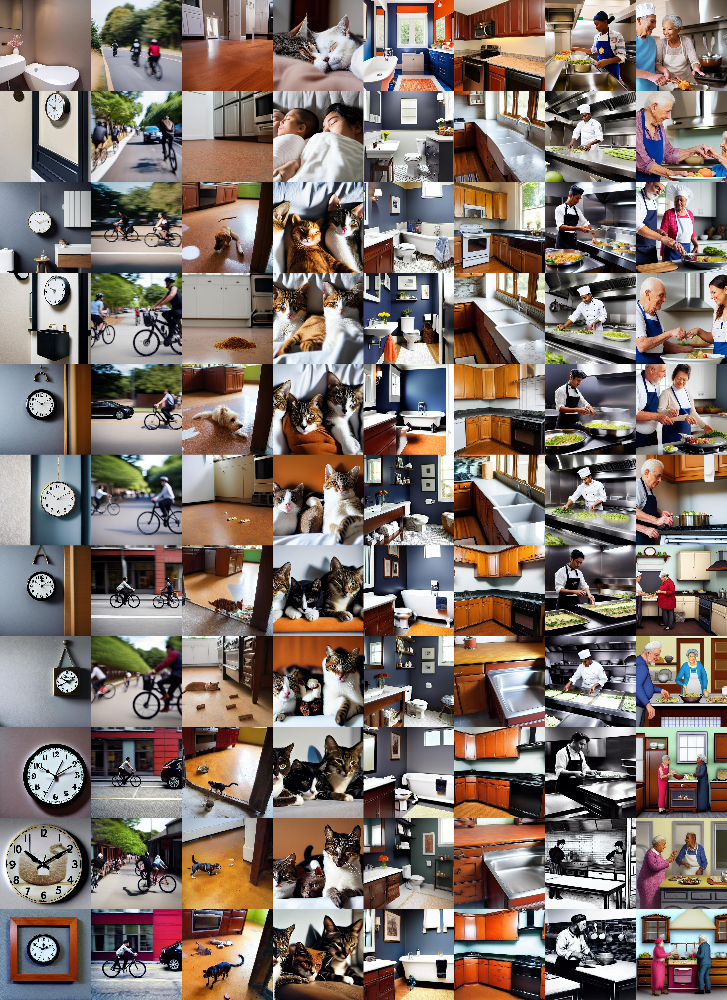

In [24]:
image